<a href="https://colab.research.google.com/github/Andikadreams/PCVK_Semester5_2023/blob/main/Week5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Nama : Andika Ainur Wibowo

NIM  : 2141720238

Kelas: 3C


**F. TUGAS PRAKTIKUM**

1. Buat Gamma Correction sesuai dengan petunjuk berikut
Percobaan ini akan meminta anda membuat Gamma Correction. Pada percobaan ini, nilai
Gamma akan diset dengan meminta masukan dari pengguna. Berikut adalah kode untuk
meminta masukan nilai dari pengguna. Lanjutkan kode tersebut dengan membuat image
dengan gamma correction sesuai rumus yang telah diberikan.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Gamma Correction pada citra
--------------------------------
masukkan nilai Gamma : 6


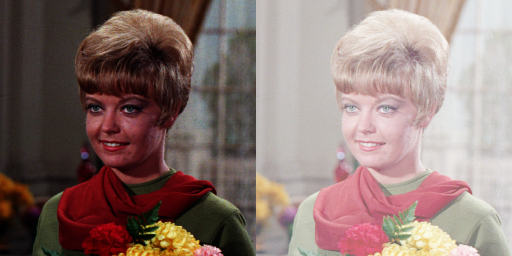

In [18]:
import numpy as np
import pandas as pd
import cv2 as cv
from google.colab.patches import cv2_imshow

#gamma correction ialah teknik yang digunakan untuk memodifikasi kontrast dan kecerahan citra dengan mengubah nilai-nilai piksel berdasarkan fungsi eksponensial.

print ('Gamma Correction pada citra')
print ('--------------------------------')
try:
  gamma = int(input('masukkan nilai Gamma : '))
except ValueError:
  print('error, not a number')

# Membaca citra
original = cv.imread('/content/drive/MyDrive/PCVK/Images/female.tiff')

# Normalisasi piksel ke dalam rentang [0, 1]
normalisasi_gambar = original / 255

# Melakukan operasi koreksi gamma
hasil = np.power(normalisasi_gambar, 1 / gamma)

# Mengembalikan piksel ke rentang [0, 255]
hasil = (hasil * 255).astype('uint8')

final_frame = cv.hconcat((original, hasil))
cv2_imshow(final_frame)

2. Buat Simulasi Image Depth
Percobaan ini digunakan sebagai simulasi dari proses kuantisasi citra. Pada kuantisasi citra,
pixel dapat direpresentasikan dengan n-bit kedalaman (default menggunakan 8-bit). Pada
pixel 8-bit, warna yang memungkinkan adalah 256 warna, dari 0 (0000 0000) hingga
255(1111 1111). Pada pixel 7-bit, warna yang memungkinkan adalah 128 warna, dari 0 (000
0000) hingga 127 (111 1111). Kemungkinan warna didapat dari pangkat 2 jumlah bit. Jika
7bit, maka jumlah warnanya adalah 27 = 128, dst.

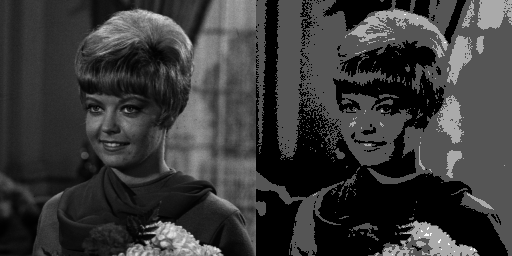

In [50]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np

bit_depth=2
level = 255 / (pow(2,bit_depth)-1)

# Membaca gambar dalam skala abu-abu
original = cv.imread('/content/drive/MyDrive/PCVK/Images/female.tiff', cv.IMREAD_GRAYSCALE)
depth_image = np.zeros(original.shape, original.dtype)
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
     depth_image[y,x] = np.clip(round(original[y,x] / level) * level, 0, 255);

final_frame = cv.hconcat((original, depth_image))
cv2_imshow(final_frame)

3. Buat modul Average Denoising
Buat modul average denoising sesuai dengan rumus yang telah diberikan pada sub bab
sebelumnya.
Citra asli sudah disediakan pada /images/galaxy.jpg.
100 Citra dengan Gaussian Noise sudah disediakan pada /images/noises/*.jpg
Anda dapat menggunakan code berikut untuk membaca semua image dalam satu folder ,
gunakan modul glob (import glob).

Catat hasil PSNR pada tabel berikut. Dari hasil yang sudah anda catat, tuliskan kesimpulan
anda:

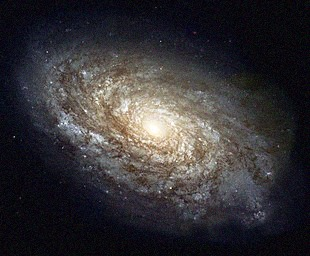

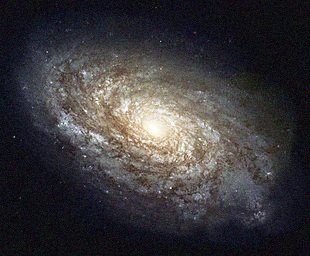

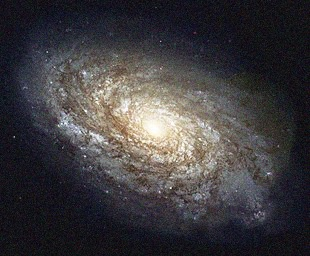

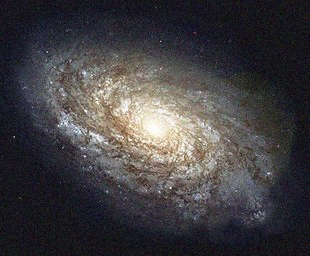

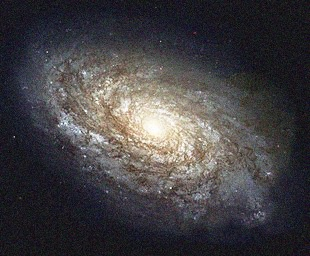

...

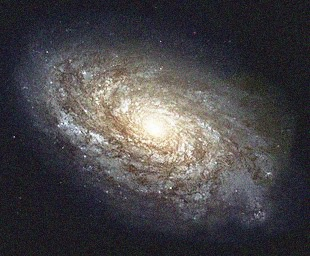

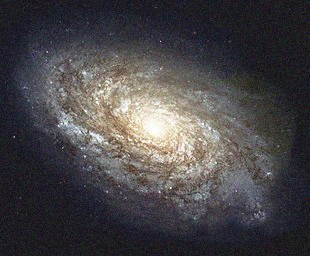

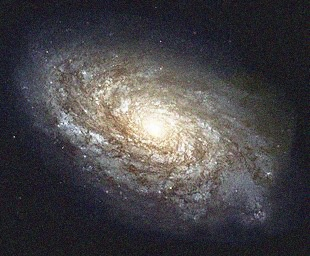

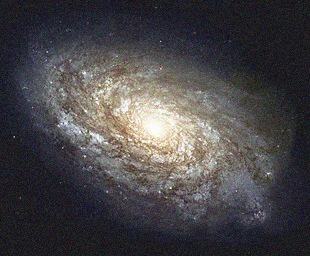

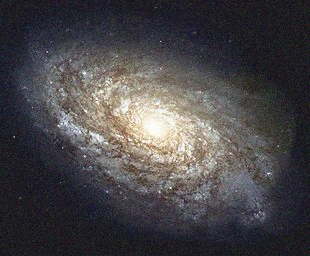

In [79]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import glob

# Membaca citra asli
original_image = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')

# Membaca semua citra dengan Gaussian Noise dari folder
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

# Inisialisasi citra gabungan dengan citra asli
combined_image = np.copy(original_image)

# Proses penggabungan citra dengan Gaussian Noise ke citra asli
for noise_image in cv_img:
    # Pastikan citra noise memiliki ukuran yang sama dengan citra asli
    noise_image = cv.resize(noise_image, (original_image.shape[1], original_image.shape[0]))

    # Lakukan penggabungan dengan operasi addWeighted
    combined_image = cv.addWeighted(combined_image, 0.7, noise_image, 0.3, 0)

    # Menampilkan citra gabungan
    cv2_imshow(combined_image)



Nilai PSNR adalah 27.53111778696065 (dB)


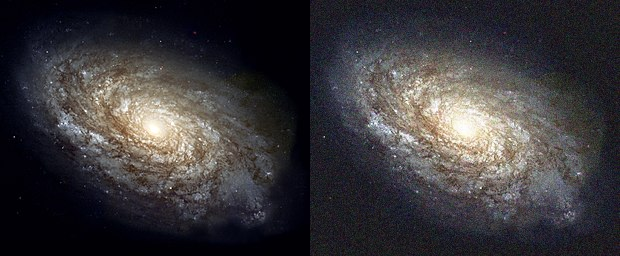

In [81]:
# 1. Jumlah Citra di Average - 5

import glob
from math import log10, sqrt

original = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

dst = cv_img[0]
noise_number = 4 # nomor (array) gambar pada folder
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal.
                  # Therefore PSNR have no importance.
      return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
final_frame = cv.hconcat((original, dst))
cv2_imshow(final_frame)

Nilai PSNR adalah 27.568424454725854 (dB)


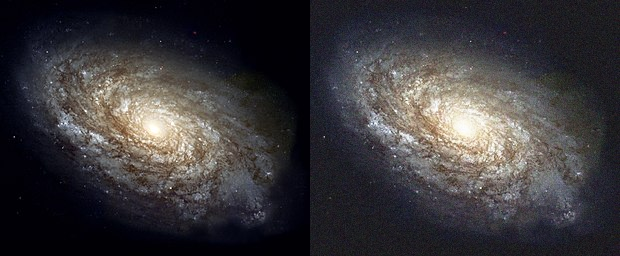

In [86]:
# 2. Jumlah Citra di Average - 10

import glob
from math import log10, sqrt

original = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

dst = cv_img[0]
noise_number = 9 # nomor (array) gambar pada folder
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal.
                  # Therefore PSNR have no importance.
      return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
final_frame = cv.hconcat((original, dst))
cv2_imshow(final_frame)

Nilai PSNR adalah 27.544522117480227 (dB)


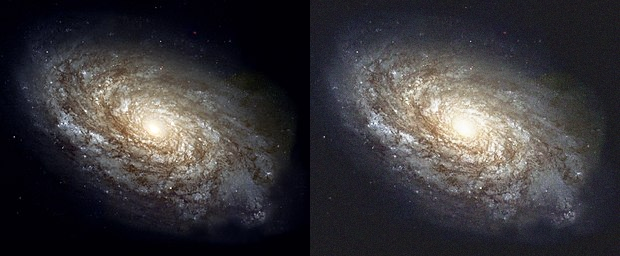

In [88]:
# 3. Jumlah Citra di Average - 20

import glob
from math import log10, sqrt

original = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

dst = cv_img[0]
noise_number = 19 # nomor (array) gambar pada folder
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal.
                  # Therefore PSNR have no importance.
      return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
final_frame = cv.hconcat((original, dst))
cv2_imshow(final_frame)

Nilai PSNR adalah 27.504885531705852 (dB)


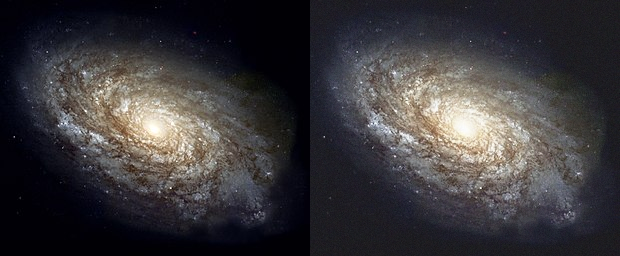

In [87]:
# 4. Jumlah Citra di Average - 40

import glob
from math import log10, sqrt

original = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

dst = cv_img[0]
noise_number = 39 # nomor (array) gambar pada folder
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE = nol berarti tidak ada noise pada sinyal.
      return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
final_frame = cv.hconcat((original, dst))
cv2_imshow(final_frame)

Nilai PSNR adalah 27.506682535608206 (dB)


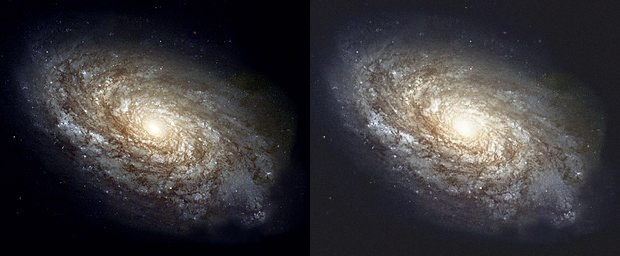

In [90]:
# 5. Jumlah Citra di Average - 80

import glob
from math import log10, sqrt

original = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

dst = cv_img[0]
noise_number = 79 # nomor (array) gambar pada folder
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE = nol berarti tidak ada noise pada sinyal.
      return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
final_frame = cv.hconcat((original, dst))
cv2_imshow(final_frame)

Nilai PSNR adalah 27.510577015362294 (dB)


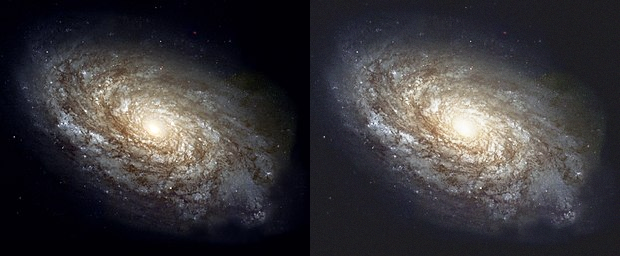

In [91]:
# 6. Jumlah Citra di Average - 100

import glob
from math import log10, sqrt

original = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

dst = cv_img[0]
noise_number = 99 # nomor (array) gambar pada folder
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE = nol berarti tidak ada noise pada sinyal.
      return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
final_frame = cv.hconcat((original, dst))
cv2_imshow(final_frame)

4. Buat image masking untuk image berikut. Image kiri adalah image asli (images/couple.tiff),
sedangkan image paling kanan adalah hasilnya:

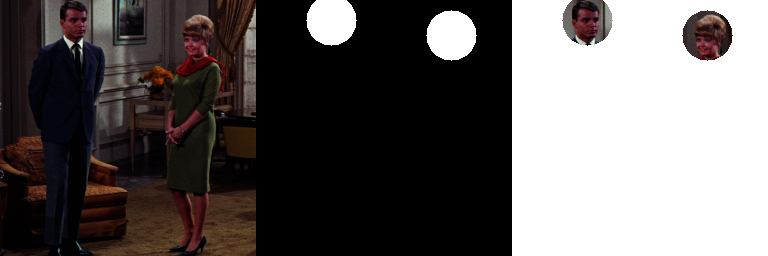

In [150]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Membaca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/Images/couple.tiff')

white = gambar_white = np.ones(original.shape, dtype=np.uint8) * 255

# Membuat gambar  kosong
gambar_kosong = np.zeros(original.shape, dtype=np.uint8)

# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(75,20),radius=25,color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(195,35),radius=25,color=(255,255,255),thickness=-1)

combine = original & gambar_kosong
mixmax = white - gambar_kosong
final = combine + mixmax

# Menampilkan gambar asli dan hasilnya
result = cv.hconcat((original, gambar_kosong, final))
cv2_imshow(result)

5. Lakukan percobaan menggunakan operator lain dan tunjukkan hasilnya pada modul ini.
Tuliskan hasil analisa anda kenapa citra keluarannya seperti itu.

**Operator NOT**

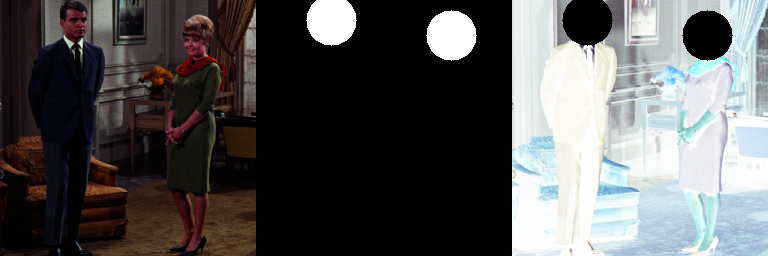

In [132]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Membaca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/Images/couple.tiff')

# Membuat gambar  kosong
gambar_kosong = np.zeros(original.shape, dtype=np.uint8)

# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(75,20),radius=25,color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(195,35),radius=25,color=(255,255,255),thickness=-1)

combine = ~original & ~gambar_kosong

# Menampilkan gambar asli dan hasilnya
result = cv.hconcat((original, gambar_kosong, combine))
cv2_imshow(result)

**Operator OR**

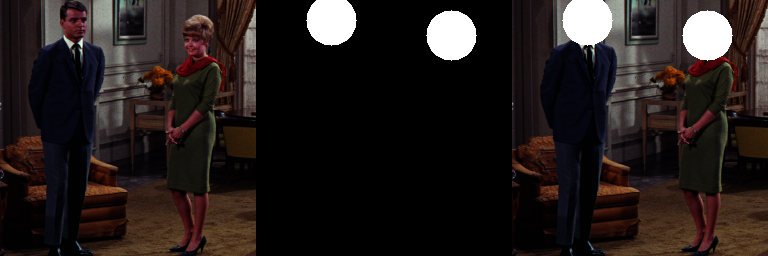

In [108]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Membaca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/Images/couple.tiff')

# Membuat gambar  kosong
gambar_kosong = np.zeros(original.shape, dtype=np.uint8)

# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(75,20),radius=25,color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(195,35),radius=25,color=(255,255,255),thickness=-1)

combine = cv.bitwise_or(original, gambar_kosong)

# Menampilkan gambar asli dan hasilnya
result = cv.hconcat((original, gambar_kosong, combine))
cv2_imshow(result)

**Operator AND**

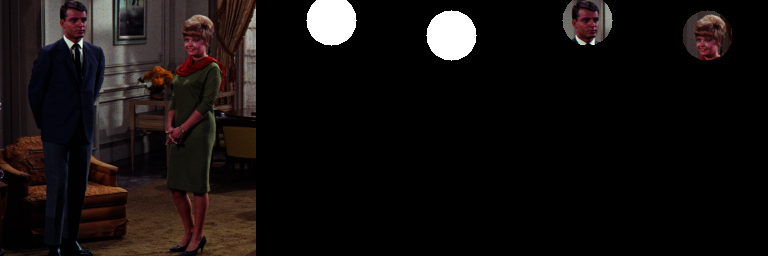

In [109]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Membaca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/Images/couple.tiff')

# Membuat gambar  kosong
gambar_kosong = np.zeros(original.shape, dtype=np.uint8)

# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(75,20),radius=25,color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(195,35),radius=25,color=(255,255,255),thickness=-1)

combine = cv.bitwise_and(original, gambar_kosong)

# Menampilkan gambar asli dan hasilnya
result = cv.hconcat((original, gambar_kosong, combine))
cv2_imshow(result)

**Operator NAND**

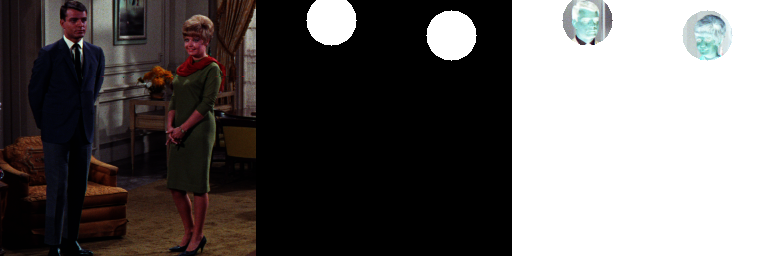

In [112]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Membaca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/Images/couple.tiff')

# Membuat gambar  kosong
gambar_kosong = np.zeros(original.shape, dtype=np.uint8)

# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(75,20),radius=25,color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(195,35),radius=25,color=(255,255,255),thickness=-1)

and_result = cv.bitwise_and(original, gambar_kosong)
combine = cv.bitwise_not(and_result)

# Menampilkan gambar asli dan hasilnya
result = cv.hconcat((original, gambar_kosong, combine))
cv2_imshow(result)

**Operator XOR**

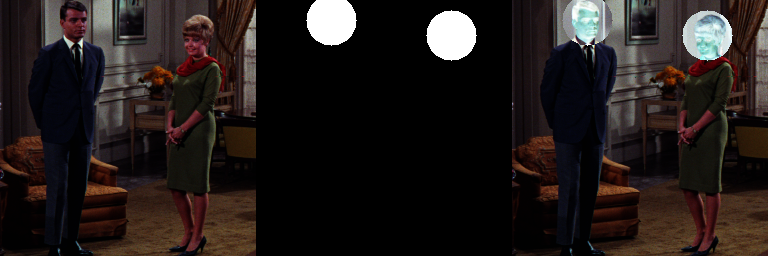

In [130]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Membaca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/Images/couple.tiff')

# Membuat gambar  kosong
gambar_kosong = np.zeros(original.shape, dtype=np.uint8)

# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(75,20),radius=25,color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
cv.circle(gambar_kosong,center=(195,35),radius=25,color=(255,255,255),thickness=-1)

combine = cv.bitwise_xor(original, gambar_kosong)

# Menampilkan gambar asli dan hasilnya
result = cv.hconcat((original, gambar_kosong, combine))
cv2_imshow(result)

TUGAS
Gunakan image masking untuk mengambil bagian tertentu dari kartu identitas menggunakan
fungsi yang telah Anda pelajari. Kemudian masing-masing simpan dalam nama image baru
- Kelompok 1 ambil bagian nomor NIK dan nama.
- Kelompok 2 ambil bagian TTL dan Jenis Kelamin.
- Kelompok 3 ambil bagian Gol. Darah dan TTD.
- Kelompok 4 ambil bagian Alamat dan Kecamatan.
- Kelompok 5 ambil bagian Agama dan Status Kawin.
- Kelompok 6 ambil Pekerjaan dan kewarganegaraan.
- Kelompok 7 ambil bagian berlaku hingga dan foto.
- Kelompok 8 ambil bagian kabupaten dan tanggal dikeluarkan KTP yang ada dibagian
bawah foto.
- Kelompok 9 ambil bagian nama propinsi dan kabupaten di bagian paling atas KTP.
- Kelompok 10 ambil bagian RT/RW dan Kel/desa.

Kelompok 4
Anggota :
1. Andika Ainur Wibowo
2. Ibnu Hajar Askholani
3. Zaky Muhammad Ibrahim

- Kelompok 4 ambil bagian Alamat dan Kecamatan.

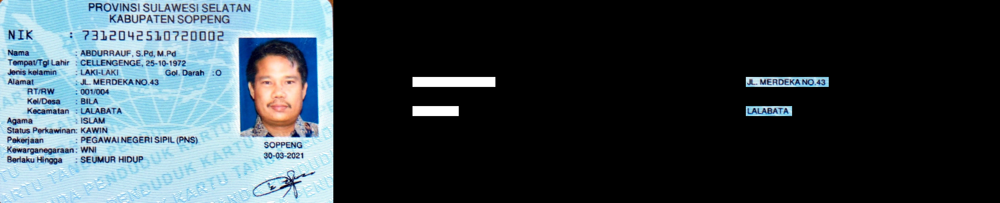

In [144]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Membaca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP.jpeg')

# Membuat gambar  kosong
gambar_kosong = np.zeros(original.shape, dtype=np.uint8)

# Gambarlah lingkaran pertama pada gambar_kosong
#cv.rectangle(gambar_kosong,pt1=(388,185),pt2=(15,208),color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
#cv.rectangle(gambar_kosong,pt1=(300,278),pt2=(58,255),color=(255,255,255),thickness=-1)


cv.rectangle(gambar_kosong,pt1=(388,185),pt2=(190,208),color=(255,255,255),thickness=-1)
# Gambarlah lingkaran pertama pada gambar_kosong
cv.rectangle(gambar_kosong,pt1=(300,278),pt2=(190,255),color=(255,255,255),thickness=-1)
combine = original & gambar_kosong

# Menampilkan gambar asli dan hasilnya
result = cv.hconcat((original, gambar_kosong, combine))
cv2_imshow(result)

